In [1]:
from xgboost import XGBRegressor
import pickle
import pandas as pd
from tqdm.notebook import tqdm
import numpy as np

import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.io as pio
pio.templates.default = 'plotly_white'

In [2]:
def energy_by_particle(df):
    patricles_dict = {pdgid: [] for pdgid in pdgids_converter.values()}
    pdgids = df['pdgids'].to_numpy()
    edeps = df['edeps'].to_numpy()
    
    for i in range(len(pdgids)):
        splitted_pdgids = pdgids[i][1:-1].split(', ')
        splitted_edeps = edeps[i][1:-1].split(', ')
        for k in range(len(splitted_pdgids)):
            try:
                particle = pdgids_converter[int(splitted_pdgids[k])]
                edep = splitted_edeps[k]
                patricles_dict[particle].append(float(edep))
            except:
                continue #print('Unknown particle: ', splitted_pdgids[k])

    return patricles_dict

In [3]:
def time_by_particle(df):
    patricles_dict = {pdgid: [] for pdgid in pdgids_converter.values()}
    pdgids = df['pdgids'].to_numpy()
    initTs = df['initTs'].to_numpy()
    
    for i in range(len(pdgids)):
        splitted_pdgids = pdgids[i][1:-1].split(', ')
        splitted_initTs = initTs[i][1:-1].split(', ')
        if '' in splitted_initTs:
            splitted_initTs.remove('')
        try:
            mini = np.min([float(x) for x in splitted_initTs])
            for k in range(len(splitted_pdgids)):
                try:
                    particle = pdgids_converter[int(splitted_pdgids[k])]
                    initT = float(splitted_initTs[k]) - mini
                    patricles_dict[particle].append(initT)
                except:
                    continue
        except:
            continue
    return patricles_dict

In [4]:
def pdgid_unique(pdgids):
    uniq = []
    uniques = list(np.unique(pdgids))
    for iid in uniques:
        splitted = iid[1:-1].split(', ')
        for pdgid in splitted:
            if pdgid != '':
                uniq.append(pdgid)
    return np.unique(uniq)

In [5]:
model = pickle.load(open("models/16_features_max_depth_10/xgb_energy_real_opt_16.dat", "rb"))

In [6]:
path='/mnt/cephfs/ml_data/mc_2021/'

In [7]:
opt_features = ['AccumCharge', 'R_cht', 'z_cc', 'pe_std',
                'nPMTs', 'ht_kurtosis', 'ht_25-20p', 'R_cc',
                'ht_5-2p', 'pe_mean', 'jacob_cht', 'phi_cc',
                'ht_35-30p', 'ht_20-15p', 'pe_35p', 'ht_30-25p']

In [8]:
pdgids_converter = dict(
    zip(
        (1000010020, 1000060130, 1000060140, 1000070140, 1000070150, 1000080170, 1000160330, 1000240510, 1000240530,
         1000240540, 1000250560, 1000260550, 1000260570, 1000260580, 1000280590, 1000280610, 11, 22, 2112, -11),
        ('H2', 'C13', 'C14', 'N14', 'N15', 'O17', 'S33', 'Cr51', 'Cr53',
         'Cr54', 'Mn56', 'Fe55', 'Fe57', 'Fe58', 'Ni59', 'Ni61', 'e-', 'γ', 'n', 'e+')
    )
)

In [9]:
calib_results = []
edeps = []
energies_by_particle = []
times_by_particle = []
options = ['AmC', 'Ge68', 'Co60']
for option in tqdm(options, 'Process type... '):
    proc_targets = pd.read_csv(f'/mnt/cephfs/ml_data/mc_2021/calib/{option}/targets_{option}.csv')
    pdgids = proc_targets['pdgids'].to_numpy()
    pdgids_uniques = pdgid_unique(pdgids)
    print(f'{option}:', [pdgids_converter[int(iid)] for iid in pdgids_uniques])
    energies_by_particle.append(energy_by_particle(proc_targets))
    times_by_particle.append(time_by_particle(proc_targets))
#     test = pd.read_csv(
#         f'{path}processed_data/ProcessedCalib/{option}/ProcessedData.csv.gz'
#     )
    
    if option == 'AmC':
#         mask = proc_targets[~proc_targets['pdgids'].str.contains("2112")].index
        mask = proc_targets[proc_targets['pdgids']!='[2112]'].index
        test = pd.read_csv(
            f'{path}processed_data/ProcessedCalib/{option}/ProcessedData.csv.gz'
        ).loc[mask]
    else:
        test = pd.read_csv(
            f'{path}processed_data/ProcessedCalib/{option}/ProcessedData.csv.gz'
        )

    edep = np.array(test['edep'])
    edeps.append(edep)
    X_test = test[opt_features]
    edep_preds = model.predict(np.array(X_test))
    calib_results.append(edep_preds)

Process type... :   0%|          | 0/3 [00:00<?, ?it/s]

AmC: ['H2', 'C13', 'C14', 'N14', 'N15', 'O17', 'S33', 'Cr51', 'Cr53', 'Cr54', 'Mn56', 'Fe55', 'Fe57', 'Fe58', 'Ni59', 'Ni61', 'e-', 'n', 'γ']
Ge68: ['e+', 'N14', 'e-', 'γ']
Co60: ['N14', 'e-', 'γ']


In [10]:
ibd_preds = np.array([])
ibd_truths = np.array([])
energies = [0, 0.1, 0.3, 0.6] + list(range(1, 11))

for energy in tqdm(energies, "Energies...", leave=False):
    test = pd.read_csv(f'{path}processed_data/ProcessedTestReal/{energy}MeV.csv.gz')
    test = test[test['edepR'] < 17.2]
    edep = np.array(test['edep'])
    X_test = test[opt_features]
    ibd_preds = np.append(ibd_preds, model.predict(X_test))
    ibd_truths = np.append(ibd_truths, edep)

Energies...:   0%|          | 0/14 [00:00<?, ?it/s]

In [11]:
# pdgids = proc_targets['pdgids'].to_numpy()
# initTs = proc_targets['initTs'].to_numpy()

# inits = []
# for i in range(len(pdgids)):
#     splitted_initTs = initTs[i][1:-1].split(', ')
#     if '' in splitted_initTs:
#         splitted_initTs.remove('')
#     for initT in splitted_initTs: 
#         inits.append(float(initT))

In [12]:
# fig = go.Figure()

# fig.add_trace(
#     go.Scattergl(
#         x=list(range(len(inits)))[:10000],
#         y=inits[:10000],
#         mode='markers',
#     )
# )

# fig.show()

In [13]:
# inits = []
# for init in proc_targets['initTs'][:1000]:
#     inits.append(float(init[1:-1].split(', ')[0]))

In [14]:
# proc_targets = pd.read_csv(f'/mnt/cephfs/ml_data/mc_2021/calib/AmC/targets_AmC.csv')
# proc_targets.head(50)

In [15]:
# fig = go.Figure()

# fig.add_trace(
#     go.Histogram(
#         x=energies_by_particle[0]['e-'],#.#loc[mask])['n'],
#         histnorm='probability'
#     )
# )

# fig.show()

In [16]:
bias = [
#    5.862510378630029,
    2.757057780780239,
    1.5029976730829018,
    0.9059695746792702,
    0.587357750346347,
    0.3843237145084628,
    0.27496770910116225,
    0.20917645422125594,
    0.16181411831677345,
    0.11764600071519864
]

bias_errors = [
#    0.03425881784246743,
    0.006750426316392479,
    0.007073061417216971,
    0.006122111181539686,
    0.004378969409808799,
    0.0045210989018870966,
    0.0035532989277091663,
    0.0038382738663529092,
    0.0034150514213853083,
    0.0034491475587722586
]

energies = np.arange(2, 11)

In [17]:
from scipy.optimize import curve_fit

def func(x, a, b, c):
    return a * x**(-b) + c

def approximated(x, y):
    popt, cov = curve_fit(func, x, y, maxfev=100000)
    a, b, c = popt
    return func(x, a, b, c), popt, cov

In [18]:
_, params, cov = approximated(energies, bias)

In [19]:
x_appr = np.linspace(1, 10, 200)
y_appr = func(x_appr, *params)

In [20]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=energies,
        y=bias,
        mode='markers',
        showlegend=False,
        marker=dict(
            color='darkviolet',
            symbol=2
        ),
        error_y=dict(
                type='data',
                width=10,
                array=bias_errors,
                visible=True
        ),
    )
)

fig.add_trace(
    go.Scatter(
        x=x_appr,
        y=y_appr,
        showlegend=False,
        line=dict(
            color='darkviolet',
        ),
    )
)

xaxis = dict(
    showline=True,
    ticks='outside',
    mirror=True,
    tick0=1,
    dtick=1,
    linecolor='black',
    showgrid=True,
    gridcolor='grey',
    gridwidth=0.25,
)

yaxis = dict(
    showline=True,
    ticks='outside',
    mirror=True,
    linecolor='black',
    showgrid=True,
    gridcolor='grey',
    gridwidth=0.25,
    zeroline=True,
    zerolinecolor='black',
    zerolinewidth=0.25
)

fig.update_layout(
    xaxis_title="Visible energy, MeV",
    yaxis_title="Bias, %",
    xaxis = xaxis,
    yaxis = yaxis,
    showlegend=False,
    font=dict(
            family="Times New Roman",
            size=18,
    ),
)

fig.show()

In [21]:
def add_bias(calib_res):
    calib_bias = func(calib_res, *params) / 100 * calib_res
    return calib_bias

In [22]:
from copy import deepcopy

calib_results_old = deepcopy(calib_results)

In [23]:
for i in range(len(calib_results)):
    if i != 1:
        calib_results[i] -= add_bias(calib_results[i])
#     if i == 0:
#         indexes = [(edeps[i] > 2) & (edeps[i] < 2.5)]
#         calib_results[i] = calib_results[i][indexes]
#         edeps[i] = edeps[i][indexes]

In [24]:
names_pred = ["Pred. energy (corrected)", "Pred. energy", "Pred. energy (corrected)"]
legend_x = [0.02, 0.02, 0.02]

In [25]:
for i in range(len(calib_results)):
    mini = edeps[i].min()
    maxi = edeps[i].max()
    size = (maxi - mini) / 100
    if i == 0:
        mini = 2
        maxi = 2.5
        size = (maxi - mini) / 20
    elif i == 1:
        mini = 0.5
        maxi = 1.5
        size = (maxi - mini) / 40
    elif i == 2:
        mini = 1
        maxi = 2.75
        size = (maxi - mini) / 30


    fig = go.Figure()

    fig.add_trace(
        go.Histogram(
            x=edeps[i],
            histnorm='probability',
            opacity=0.75,
            name="True energy",
            marker=dict(
                color='darkred',
                line=dict(
                    color='black',
                    width=2,
                )
            ),
            xbins=dict(
                start=mini,
                end=maxi,
                size=size
            )
        )
    )
    
    if i != 1:
        fig.add_trace(
            go.Histogram(
                x=calib_results_old[i],
                histnorm='probability',
                opacity=0.4,
                name="Pred. energy",
                marker=dict(
                    color='rgb(102, 166, 30)',
                    line=dict(
                        color='black',
                        width=2,
                    )
                ),
                xbins=dict(
                    start=mini,
                    end=maxi,
                    size=size
                )
            )
        )

    fig.add_trace(
        go.Histogram(
            x=calib_results[i],
            histnorm='probability',
            opacity=0.75,
            name=names_pred[i],
            marker=dict(
                color='darkblue',
                line=dict(
                    color='black',
                    width=2,
                )
            ),
            xbins=dict(
                start=mini,
                end=maxi,
                size=size
            )
        )
    )
    
#     if i == 1:
#         fig.add_trace(
#             go.Histogram(
#                 x=ibd_preds,
#                 histnorm='probability',
#                 opacity=0.6,
#                 name="Reconstruction energy: IBD",
#                 marker=dict(
#                     color='green'
#                 ),
#                 xbins=dict(
#                     start=mini,
#                     end=maxi,
#                     size=size
#                 )
#             )
#         )

    xaxis = lambda range: dict(
        showline=True,
        ticks='outside',
        mirror=True,
        dtick=round((maxi-mini)/8, 0),
        range=range,
        linecolor='black',
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
    )

    yaxis = dict(
        showline=True,
        ticks='outside',
        mirror=True,
        linecolor='black',
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
        zeroline=True,
        zerolinecolor='black',
        zerolinewidth=0.25
    )

    fig.update_layout(
        xaxis_title="Deposited energy, MeV",
#         title=options[i],
        barmode='overlay',
        width=600,
        height=600,
        xaxis=xaxis([mini, maxi]),
        yaxis=yaxis,
        legend_title_text=options[i]+":",
        legend=dict(
            x=legend_x[i],
            y=0.97,
            title_font_family="Times New Roman",
            font=dict(
                family="Times New Roman",
                size=18,
                color="black"
            ),
            bordercolor="Black",
            borderwidth=1
        ),
        font=dict(
            family="Times New Roman",
            size=18,
            color="black"
        ),
    )

    fig.show()
    pio.write_image(
        fig, f'plots/calib/{options[i]}/xgb_predict_{options[i]}.pdf',
        width=700, height=600)

In [26]:
# pio.templates.default = 'plotly_white'

# for i in range(len(calib_results)):
#     diff = calib_results[i] - edeps[i]
#     fig = go.Figure()

#     fig.add_trace(
#         go.Histogram(
#             x=diff,
#             histnorm='probability',
#             opacity=0.6,
#             name=r'$E_{rec}   $',
#             xbins=dict(
#                 start=diff.min(),
#                 end=diff.max(),
#                 size=(diff.max()-diff.min()) / 100
#             )
#         )
#     )

#     fig.update_layout(
#         xaxis_title=r"$$E_{rec}}$$",
#         title=options[i],
#         barmode='overlay',
#         width=900,
#         height=600,
#         legend=dict(
#             x=0.85,
#             y=0.99,
#             title_font_family="Times New Roman",
#             font=dict(
#                 family="Times New Roman",
#                 size=20,
#                 color="black"
#             ),
#             bordercolor="Black",
#             borderwidth=1
#         ),
#         font=dict(
#             family="Times New Roman",
#             size=20,
#         ),
#     )

#     fig.show()

In [27]:
calib_results.append(ibd_preds)
edeps.append(ibd_truths)
options.append(r'$\huge{e^+}$')

In [28]:
dfs = []
for i in range(len(edeps)):
    dfs.append(
        pd.DataFrame(
            np.transpose([calib_results[i], edeps[i]]),
            columns=['Reconstructed deposited energy, MeV', 'True deposited energy, MeV']
        )
    )

In [29]:
import plotly.express as px
import datashader as ds

def corr_2d_vis(df, lim_min, lim_max,
                xmin, xmax, ymin, ymax,
                annotation_name, width=100,
                height=100, x_annotation=0.045,
                dash_line=True):
    print(options[i])
    cvs = ds.Canvas(plot_width=width, plot_height=height)
    agg = cvs.points(df, 'Reconstructed deposited energy, MeV', 'True deposited energy, MeV')
    zero_mask = agg.values == 0
    agg.values = np.log10(agg.values, where=np.logical_not(zero_mask))
    agg.values[zero_mask] = np.nan
    
    xaxis = lambda range: dict(
        showline=True,
        ticks='outside',
        mirror=True,
        dtick=round((xmax-xmin)/8, 0),
        range=range,
        linecolor='black',
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
    )

    yaxis = lambda range: dict(
        showline=True,
        ticks='outside',
        mirror=True,
        linecolor='black',
        range=range,
        dtick=round((ymax-ymin)/8, 0),
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
        zeroline=True,
        zerolinecolor='black',
        zerolinewidth=0.25
    )
    
    fig = px.imshow(agg, origin='lower',
                    labels={'color':'Log10(count)'},
                    color_continuous_scale='inferno')
    fig.update_traces(hoverongaps=False)
    
    if dash_line:
        fig.add_shape(
            type="line",
            x0=lim_min, y0=lim_min,
            x1=lim_max, y1=lim_max,
            line=dict(
                color="darkviolet",
                width=2,
                dash="dashdot",
            ),
            opacity=0.9
        )

    fig.add_shape(
        type='rect',
        x0=0.03,
        x1=0.18,
        y0=0.8,
        y1=0.95,
        xref="paper",
        yref="paper",
        line_color='black',
        line_width=3,
        fillcolor='white'
    )
    
    fig.add_annotation(
        x=x_annotation,
        y=0.92,
        text=annotation_name,
        xref="paper",
        yref="paper",
        showarrow=False,
        font_size=30,
        font_color='black'
    )


    fig.update_layout(
        coloraxis_colorbar=dict(
            title='Count',
            tickprefix='1.e'
        ),
        showlegend=True,
        xaxis=xaxis([xmin, xmax]),
        yaxis=yaxis([ymin, ymax]),
        font=dict(
            family="Times New Roman",
            size=22,
            color='black'
        ),
        title=dict(
            xanchor='center',
            x=0.5,
#             text=options[i]
        )
    )
    
    fig.show()
    pio.write_image(
        fig, f'plots/calib/{annotation_name}/corr_2d_vis_{annotation_name}.pdf',
        width=800, height=600)

In [30]:
for i in range(len(edeps)):
    if i == 0:
        xmin = ymin = 2
        xmax = ymax = 2.5
        width = 120
        height = 40
        df = dfs[i][
            (dfs[i]['True deposited energy, MeV'] > xmin) & 
            (dfs[i]['True deposited energy, MeV'] < xmax)
        ]
        x_annotation = 0.05
        annotation_name = options[i]
    elif i == 1:
        xmin = ymin = 0.5
        xmax = ymax = 1.4
        width = 100
        height = 50
        df = dfs[i][
            (dfs[i]['True deposited energy, MeV'] > xmin) & 
            (dfs[i]['True deposited energy, MeV'] < xmax)
        ]
        x_annotation = 0.05
        annotation_name = options[i]
    elif i == 2:
        xmin = ymin = 1
        xmax = ymax = 2.75
        width = 100
        height = 50
        df = dfs[i][
            (dfs[i]['True deposited energy, MeV'] > xmin) & 
            (dfs[i]['True deposited energy, MeV'] < xmax)
        ]
        x_annotation = 0.05
        annotation_name = options[i]
    else:
        xmin = dfs[i].min()[0]
        xmax = dfs[i].max()[0]
        ymin = dfs[i].min()[1]
        ymax = dfs[i].max()[1]
        width = 100
        height = 100
        x_annotation = 0.08
        annotation_name = 'e+'
        df = dfs[i]
    corr_2d_vis(df, lim_max=ymax,#df.max().max(),
                lim_min=df.min()['True deposited energy, MeV'],
                xmin=xmin, xmax=xmax,
                ymin=ymin, ymax=ymax,
                width=width, height=height,
                x_annotation=x_annotation,
                annotation_name=annotation_name)

AmC


Ge68


Co60


$\huge{e^+}$


- 1) ACU - automated calibration units.
Во время обычного сбора данных о нейтрино источники нейтронов “припаркованы” внутри ACU прямо над AD (antineutrino detector). Хотя эти нейтроны редко попадают непосредственно в нейтринную мишень (жидкий сцинтиллятор), они могут попадать на окружающие материалы, в частности, на нержавеющую сталь, т. e. Fe, Mn, Cr, Ni и т.д., И испускать гамма в диапазоне от 6 до 10 МэВ.

- 2) Существует несколько типов часто используемых калибровочных нейтронных источников:
    - источник деления ${}^{252}$Cf
    - источник ($\alpha, n$) ${}^{241}$Am-Be
    - фотон-нейтронный источник ${}^{124}$Sb-Be.

Типичные ($\alpha, n$) источники имеют коррелированное гамма-нейтронное излучение, когда ядро конечного состояния находится в возбужденном состоянии. Такие источники неизбежно приводят к коррелированному фону в AD в добавлении к случайному фону.

${}^{241}$Am-${}^{13}$С может производить нейтроны с конечным состоянием ${}^{16}$O либо в основном состоянии, либо в первом или втором возбужденном состоянии. 
- Первое возбужденное состояние ${}^{16}$O распадается на электрон-позитронную пару, которая будет остановлена корпусом источника и окружающими материалами. 
- Второе возбужденное состояние ${}^{16}$O будет излучать гамма-излучение с энергией 6.13 МэВ, создавая коррелированный фон вместе с нейтроном.

Однако, если энергия α уменьшена до уровня ниже 5.11 МэВ, этот коррелированный процесс γ-нейтронов может быть полностью устранен.

Когда источники развертываются в детекторе, отдача протона и следующие гаммы захвата образуют коррелированные по времени пары, аналогичные сигналам IBD. Средняя скорость нейтронов, измеренная в детекторе, составляет 0,7 Гц, что соответствует измерениям контроля качества в Калифорнийском технологическом институте.

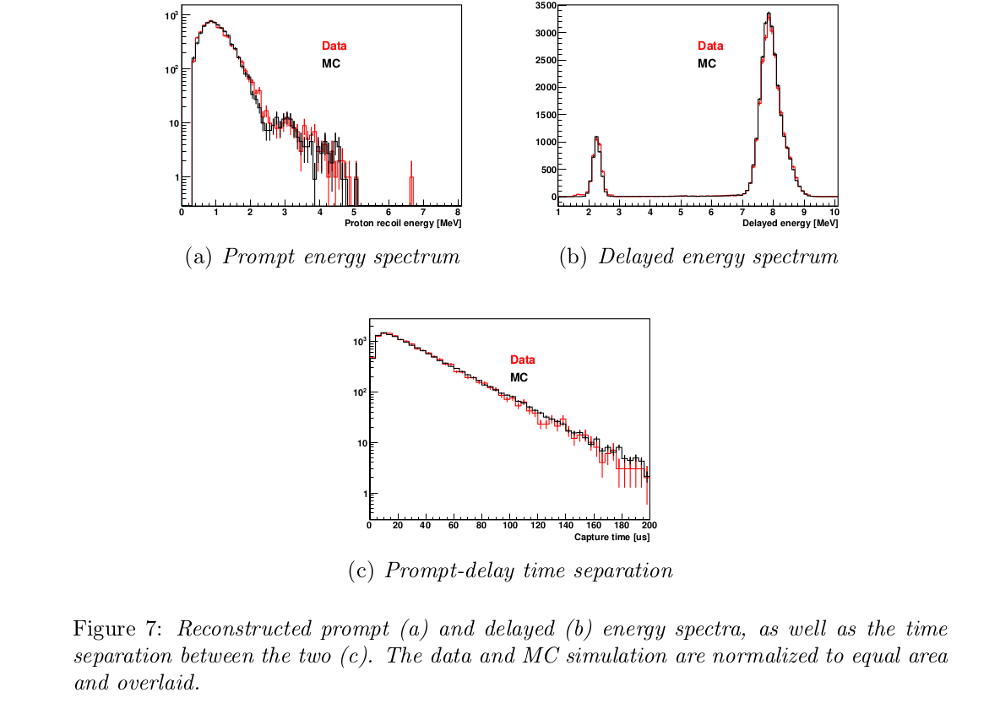

Нейтроноподобные события из источников AmC генерируются захватами гаммами от элементов SS (stainless steel).